In [1]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_columns_by_frequency(
    df, columns, 
    freq='D', 
    ignore_datetimes=False, 
    vertical_lines=None,
    line_text=None
):
    """
    Plot columns from a dataframe based on specified frequency.
    
    df: pandas DataFrame with a datetime index
    columns: list of columns to plot
    freq: frequency for plotting ('D' for day, 'W' for week, 'M' for month, 'Y' for year, or integer if ignore_datetimes=True)
    ignore_datetimes: if True, plots against a dummy index instead of datetimes
    vertical_lines: list of 2-tuple with datetimes indicating positions for vertical lines. 
                    The first datetime is plotted as a red line and the second as a green line.
    """

    if ignore_datetimes:
        if isinstance(freq, int):
            num_points = freq
        else:
            raise ValueError("When ignore_datetimes=True, freq should be an integer representing number of points.")
        
        indices = list(range(0, len(df), num_points))
        if indices[-1] != len(df):
            indices.append(len(df))

        for start, end in zip(indices[:-1], indices[1:]):
            subset = df.iloc[start:end]
            plt.figure(figsize=(10, 6))
            subset[columns].plot(ax=plt.gca(), marker='.', linestyle='--', secondary_y=True)
            
            if vertical_lines:
                for line in vertical_lines:
                    if df.index[start] <= line[0] <= df.index[end-1]:
                        idx_before = df.index.get_loc(line[0], method='ffill')
                        idx_after = df.index.get_loc(line[0], method='bfill')
                        pos = (idx_before + idx_after) / 2 - start
                        plt.axvline(x=pos, color='red')
                    
                    if df.index[start] <= line[1] <= df.index[end-1]:
                        idx_before = df.index.get_loc(line[1], method='ffill')
                        idx_after = df.index.get_loc(line[1], method='bfill')
                        pos = (idx_before + idx_after) / 2 - start
                        plt.axvline(x=pos, color='green')
            
            plt.title(f'Data from {subset.index[0]} to {subset.index[-1]}')
            plt.show()

    else:
        for sub_df in df.resample(freq):
            label, subset = sub_df
            if not subset.empty:
                plt.figure(figsize=(10, 6))
                subset[columns].plot(ax=plt.gca(), marker='.', linestyle='--', secondary_y=True)
                if vertical_lines:
                    for (line_idx, line) in enumerate(vertical_lines):
                        line_plotted=False
                        if subset.index[0] <= line[0] <= subset.index[-1]:
                            plt.axvline(x=line[0], color='red')
                            line_plotted=True
                        if subset.index[0] <= line[1] <= subset.index[-1]:
                            plt.axvline(x=line[1], color='green')
                            line_plotted=True
                        if line_plotted and len(line_text) == len(vertical_lines):
                            print(f'line:{line_idx}, reason:{line_text[line_idx]}')
                            
                plt.title(f'Data from {subset.index[0]} to {subset.index[-1]}')
                plt.show()

In [2]:
def clean_data(df):
    df = df[(df['Extruder Pressure'] >= 0) & (df['Extruder Pressure'] < 50000)]
    
    return df

In [3]:
def get_machine_pauses(df, time_threshold=30):
    time_diff = -1*(df['Date and Time'].diff(-1).dt.total_seconds()/60)
    #time_diff = (df['Date and Time'].shift(-1) - df['Date and Time']).dt.total_seconds()/60

    machine_pauses = df[time_diff > time_threshold]['Date and Time']
    
    return machine_pauses

def calculate_time_difference(df, time_threshold=30):
    time_diff = -1*(df['Date and Time'].diff(-1).dt.total_seconds()/60)
    #time_diff = (df['Date and Time'].shift(-1) - df['Date and Time']).dt.total_seconds()/60

    return time_diff

In [6]:
#def filter_on_datetime(df, datecol, datetime, window_in_hours):
#    
#    return(df[df[datecol] >])
#    

In [20]:
extruder_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 233321 entries, 1 to 233321
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   Date and Time                      233321 non-null  object
 1   Extruder Pressure                  233279 non-null  object
 2   Screw Speed Output                 233283 non-null  object
 3   Screw Speed                        233301 non-null  object
 4   Extruder Die Temp                  233295 non-null  object
 5   Extruder Thrust                    233285 non-null  object
 6   Feed Screw Current (Amps)          233288 non-null  object
 7   Discharge Conveyor Current (Amps)  233287 non-null  object
 8   Discharge Conveyor Speed (%)       233286 non-null  object
dtypes: object(9)
memory usage: 16.0+ MB


In [16]:
import pandas as pd
import re



#columns_oi = ['Extruder Pressure', 'Extruder Thrust', 'Extruder Die Temp']
columns_oi = ['Extruder Pressure']

# Read the CSV file into a DataFrame
extruder_data = pd.read_csv("ex4-data.csv",)
extruder_data = extruder_data.drop(extruder_data.index[0])

print(f'raw_shape: {extruder_data.shape}')


# Define the pattern
pattern = r'<null>'

# Filter rows where any column matches the pattern
matching_rows = extruder_data.applymap(
    lambda x: bool(re.search(pattern, str(x)))
).any(axis=1)

filtered_df = extruder_data[matching_rows]

print(filtered_df.shape[0])
filtered_df.head(5)

/tmp/ipykernel_8946/817647564.py:8: DtypeWarning: Columns (2,3,4,5,6,7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  extruder_data = pd.read_csv("ex4-data.csv",)
/tmp/ipykernel_8946/817647564.py:15: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  matching_rows = extruder_data.applymap(


59


,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%)
143578,2/26/2023 2:52 PM,<null>,<null>,<null>,<null>,99.29,0,0,50
143579,2/26/2023 2:52 PM,<null>,<null>,<null>,<null>,<null>,<null>,<null>,50
143580,2/26/2023 2:52 PM,<null>,<null>,<null>,<null>,<null>,<null>,<null>,<null>
143581,2/26/2023 2:53 PM,<null>,<null>,-0.94,<null>,<null>,<null>,<null>,<null>
143582,2/26/2023 2:53 PM,<null>,<null>,-0.94,397.92,<null>,<null>,<null>,<null>


In [19]:
extruder_data = extruder_data.replace("<null>", None)

In [22]:
extruder_data = extruder_data.dropna()

# Convert the column to string type
for column in extruder_data.columns:
    if column not in ["Date and Time", "AnomalyScore"]:
        extruder_data[column] = extruder_data[column].astype(str)
        #extruder_data[column] = extruder_data[column].str.replace("<null>", None)
        # Replace commas with an empty string
        extruder_data[column] = extruder_data[column].str.replace(",", "")

        # Convert the column back to numeric type, handling any conversion errors
        extruder_data[column] = pd.to_numeric(extruder_data[column], errors="coerce")
        
extruder_data['Date and Time'] = pd.to_datetime(extruder_data['Date and Time'])
machine_pauses = get_machine_pauses(extruder_data, time_threshold=10)
extruder_data = clean_data(extruder_data)
extruder_data = extruder_data.groupby('Date and Time').mean()
extruder_data['Date and Time'] = extruder_data.index
# extruder_data = pd.read_csv("ex4-data.csv",)

#extruder_data = extruder_data.fillna(value=0)
#extruder_data = extruder_data.dropna(subset=columns_oi)

time_diff = -1*(extruder_data['Date and Time'].diff(-1).dt.total_seconds()/60)
# # Remove the comma from the string

KeyError: 'Date and Time'

In [89]:
extruder_data.head()

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%)
Date and Time,,,,,,,,
2022-11-08 08:45:00,4174.38,63.1,-0.94,11.28,34.120,5.21,0.95,75.36
2022-11-08 08:46:00,4521.09,63.1,-0.94,11.28,34.370,5.21,0.95,75.36
2022-11-08 08:49:00,4521.09,63.1,-0.94,11.28,34.620,5.21,1.01,75.36
2022-11-08 08:50:00,4521.09,63.1,-0.94,11.28,34.035,5.21,0.90,75.36
2022-11-08 08:53:00,4337.32,63.1,-0.94,11.28,33.450,1.74,0.90,75.36


In [ ]:
machine_pauses = get_machine_pauses(extruder_data)
len(machine_pauses)

In [ ]:
calculate_time_difference(extruder_data)

In [115]:
#date_oi = pd.to_datetime('1/21/23').date()
#test = extruder_data[extruder_data.index.date == date_oi]
#print(date_oi)
#test.iloc[275:325]

,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%)
Date and Time,,,,,,,,
2023-01-21 17:26:00,3250.000000,25.0,-0.94,12.25,48.720000,4.470000,0.940000,80.0
2023-01-21 17:27:00,3250.000000,25.0,-0.94,12.25,47.440000,4.470000,0.940000,80.0
2023-01-21 17:28:00,3745.620000,25.0,-0.94,12.25,47.440000,4.470000,0.940000,80.0
2023-01-21 17:32:00,3745.620000,25.0,-0.94,12.25,48.020000,1.710000,0.940000,80.0
2023-01-21 17:33:00,3662.343333,25.0,-0.94,12.25,48.761667,0.000000,0.976667,80.0
2023-01-21 17:35:00,3594.730000,25.0,-0.94,12.25,49.150000,0.000000,0.960000,80.0
2023-01-21 17:36:00,3663.273333,25.0,-0.94,12.25,49.150000,5.256667,0.960000,80.0
2023-01-21 17:37:00,3800.360000,25.0,-0.94,12.25,49.150000,5.020000,0.950000,80.0
2023-01-21 17:39:00,3353.120000,25.0,-0.94,12.25,49.150000,5.020000,0.950000,80.0


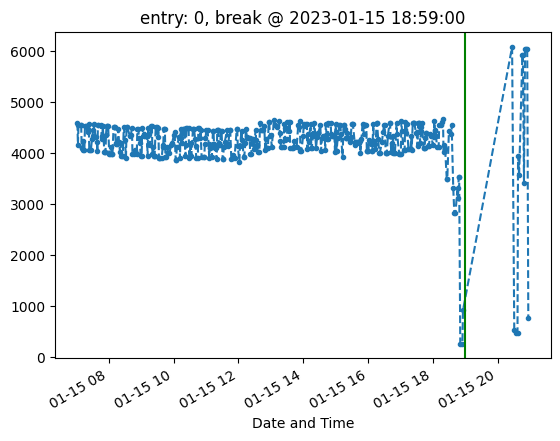

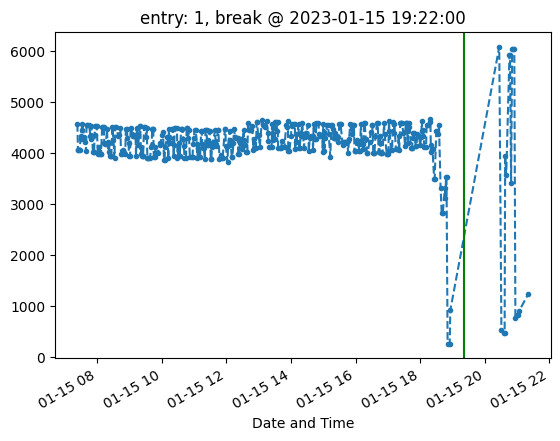

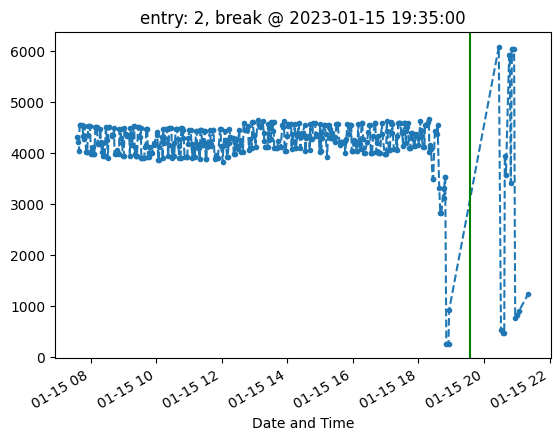

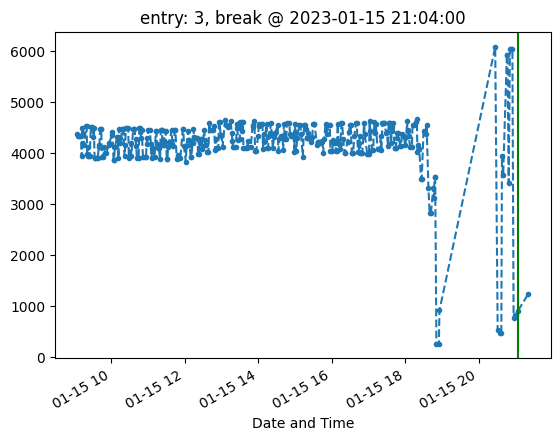

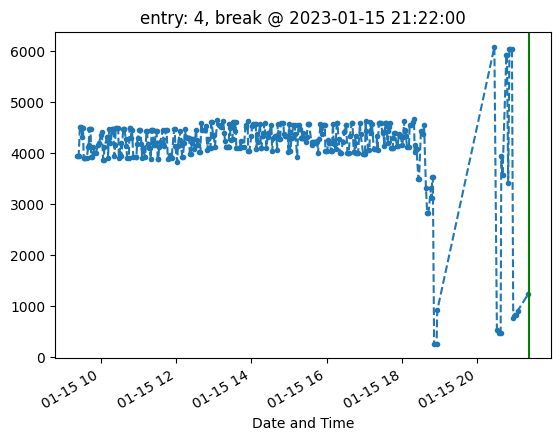

...

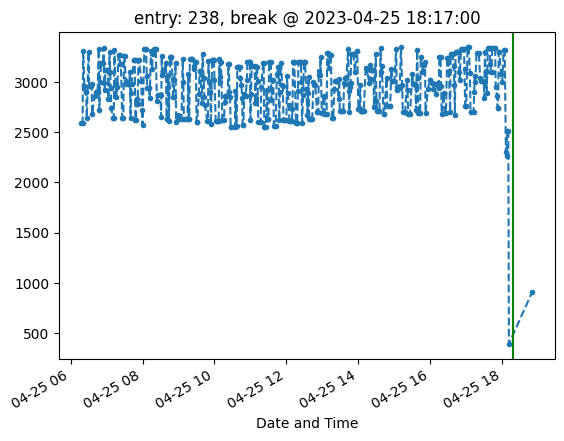

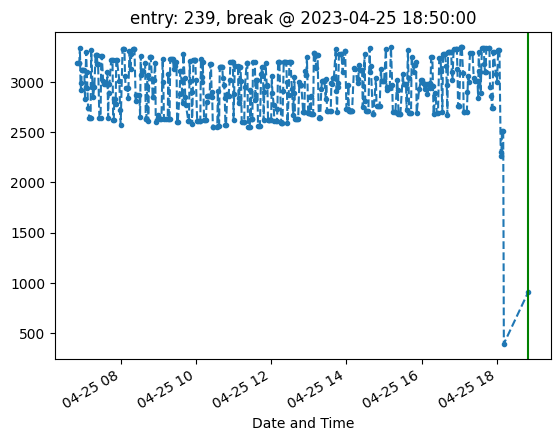

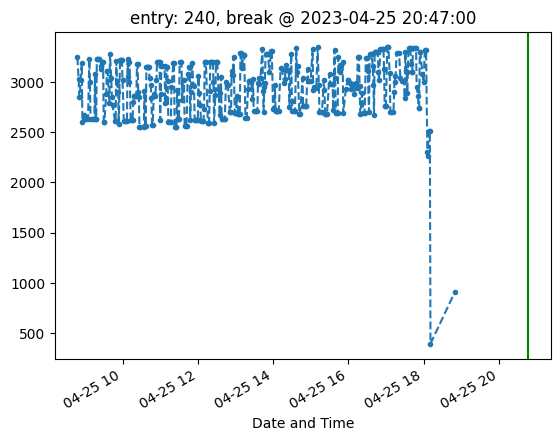

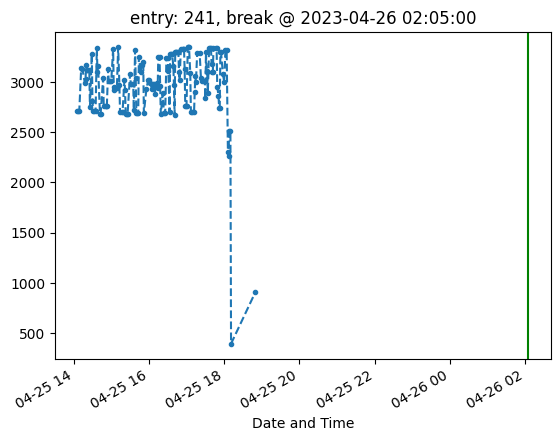

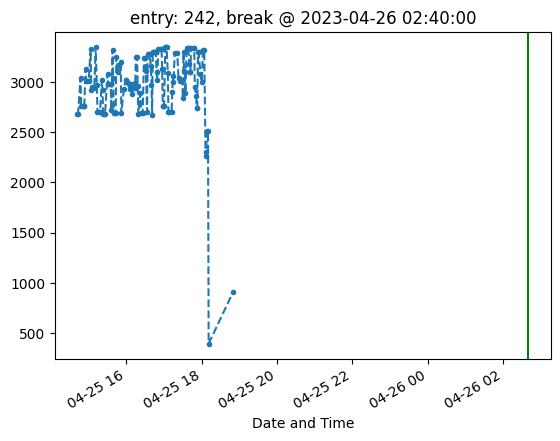

In [120]:
for (i, pause_time) in enumerate(machine_pauses):
    
    early_cutoff = pause_time - pd.Timedelta(hours=12)
    late_cutoff = pause_time + pd.Timedelta(hours=2)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, break @ {pause_time}')
    plt.show()
    #break

In [129]:
machine_pauses

130330   2023-01-15 18:59:00
130331   2023-01-15 19:22:00
130332   2023-01-15 19:35:00
130368   2023-01-15 21:04:00
130371   2023-01-15 21:22:00
                 ...        
233312   2023-05-07 13:05:00
233313   2023-05-07 20:21:00
233315   2023-05-07 20:56:00
233316   2023-05-08 04:11:00
233318   2023-05-08 04:46:00
Name: Date and Time, Length: 317, dtype: datetime64[ns]

In [126]:
days = extruder_data.index.normalize().unique().tolist()

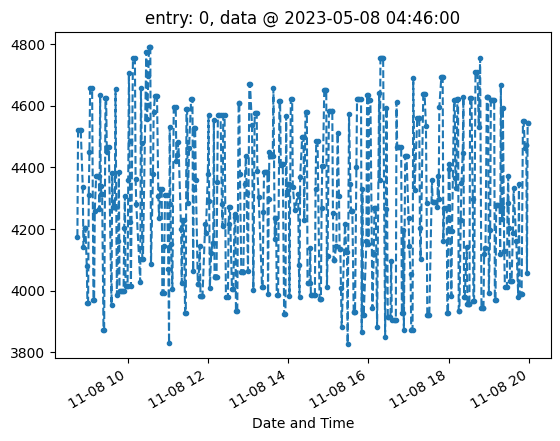

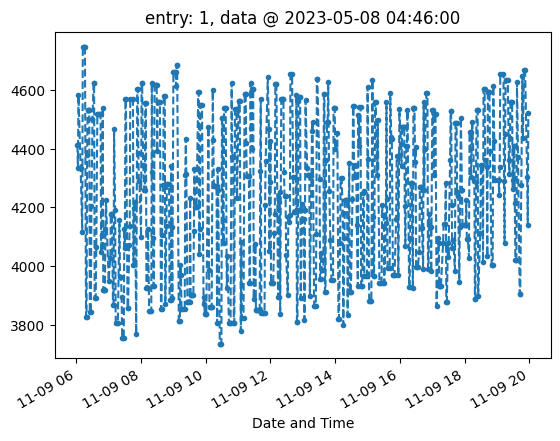

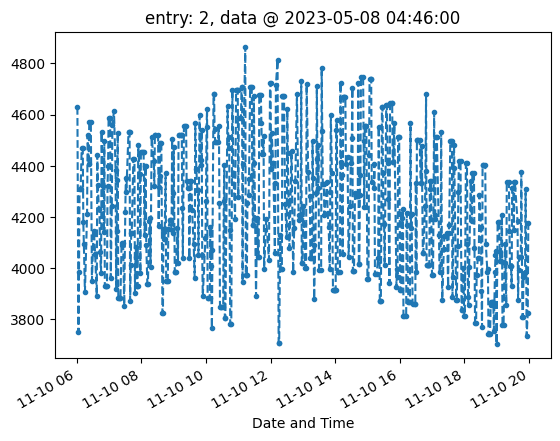

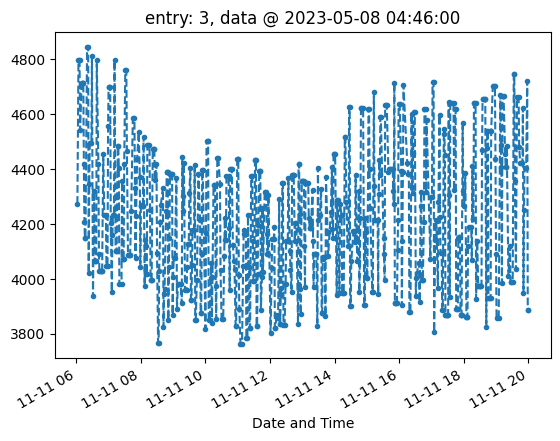

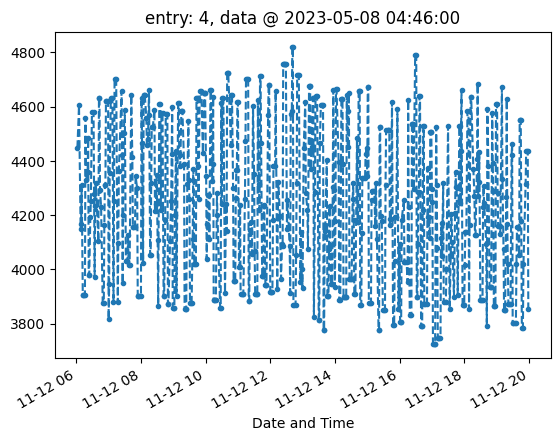

...

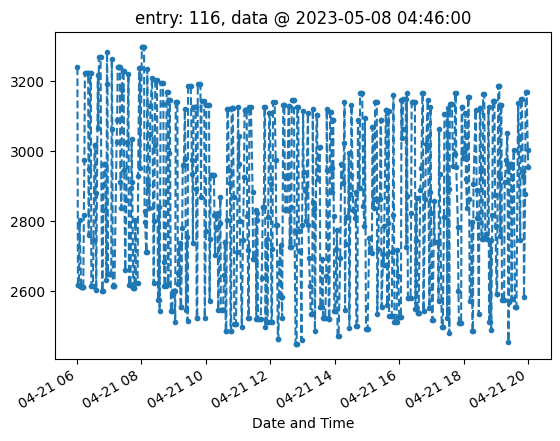

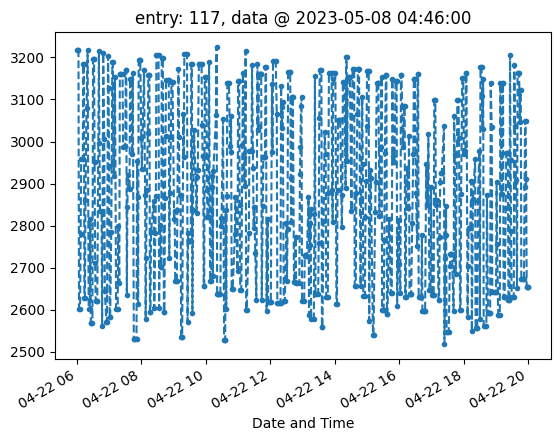

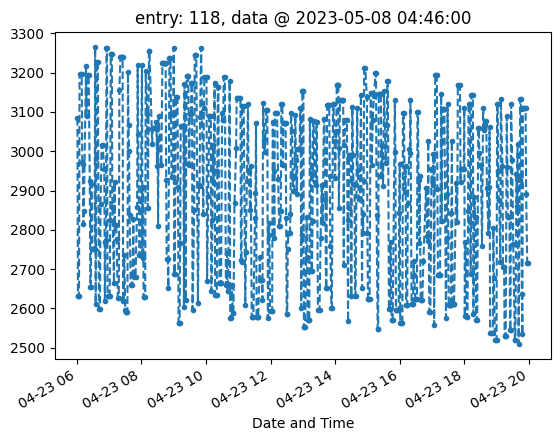

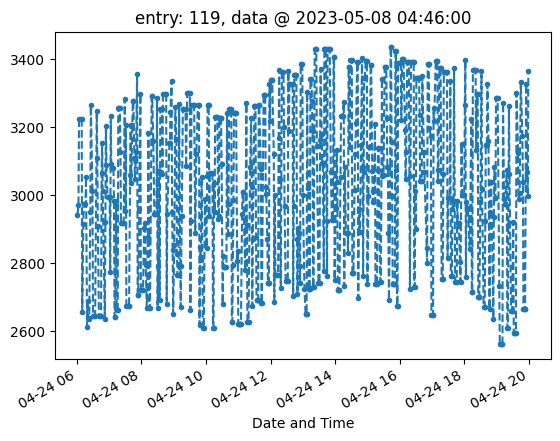

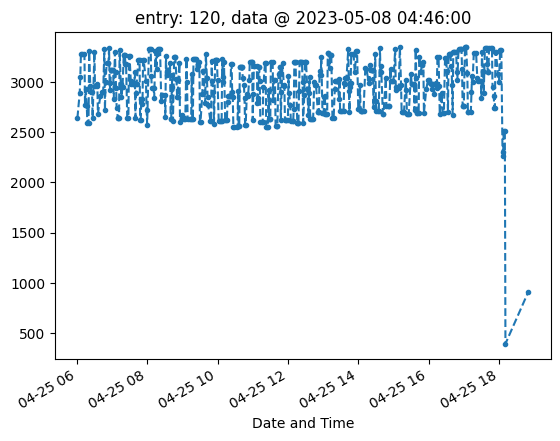

In [128]:
for (i, day) in enumerate(days):
    
    early_cutoff = day + pd.Timedelta(hours=6)
    late_cutoff = day + pd.Timedelta(hours=20)
    mask = (extruder_data.index > early_cutoff) & \
               (extruder_data.index <= late_cutoff)
    
    pauses = 
    
    #print(early_cutoff, late_cutoff)
    
    time_filtered_data = extruder_data[mask]['Extruder Pressure']
    if time_filtered_data.shape[0] < 100:
        continue
    #print(time_filtered_data.shape)
    
    time_filtered_data.plot(marker='.', linestyle='--')
    #plt.axvline(x=pause_time, color='green')
    plt.title(f'entry: {i}, data @ {pause_time}')
    plt.show()
    #break

In [85]:
len(machine_pauses)

275

In [59]:
extruder_data['minutes_pause'] = 

In [62]:
extruder_data.tail(5)

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),minutes_pause
233317,2023-05-08 04:45:00,-60.14,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,34.0
233318,2023-05-08 04:46:00,-59.73,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,1.0
233319,2023-05-08 09:37:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,291.0
233320,2023-05-08 09:42:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,5.0
233321,2023-05-08 09:45:00,-59.61,25.0,-0.94,397.88,-0.83,0.0,0.0,70.0,3.0


In [58]:
extruder_data['Date and Time'].min(), extruder_data['Date and Time'].max()

(Timestamp('2022-11-08 08:45:00'), Timestamp('2023-05-08 09:45:00'))

In [20]:
extruder_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 233321 entries, 1 to 233321
Data columns (total 9 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Date and Time                      233321 non-null  object 
 1   Extruder Pressure                  233321 non-null  float64
 2   Screw Speed Output                 233321 non-null  float64
 3   Screw Speed                        233321 non-null  float64
 4   Extruder Die Temp                  233321 non-null  float64
 5   Extruder Thrust                    233321 non-null  float64
 6   Feed Screw Current (Amps)          233321 non-null  float64
 7   Discharge Conveyor Current (Amps)  233321 non-null  float64
 8   Discharge Conveyor Speed (%)       233321 non-null  float64
dtypes: float64(8), object(1)
memory usage: 16.0+ MB


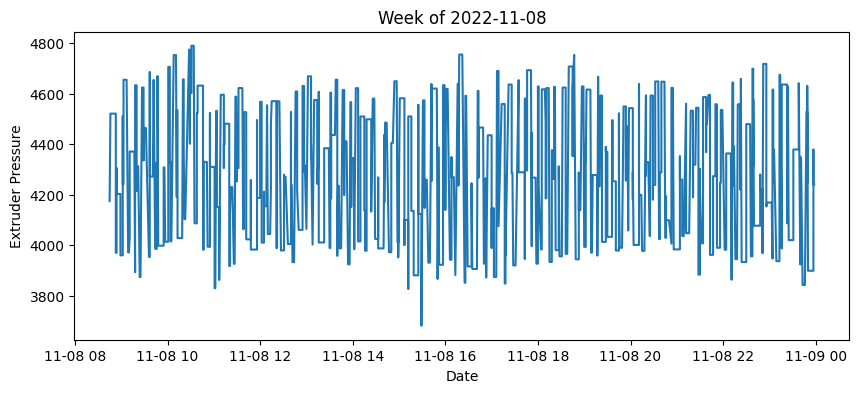

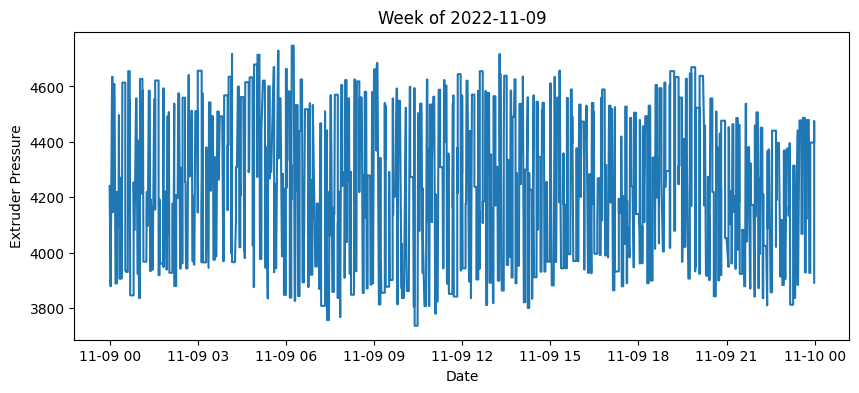

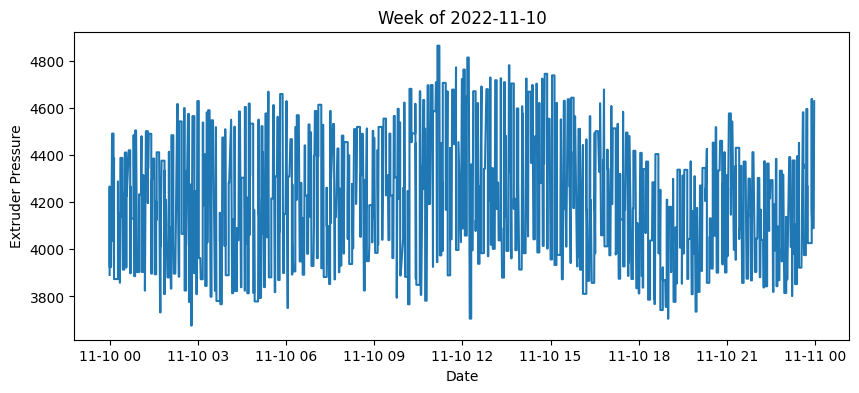

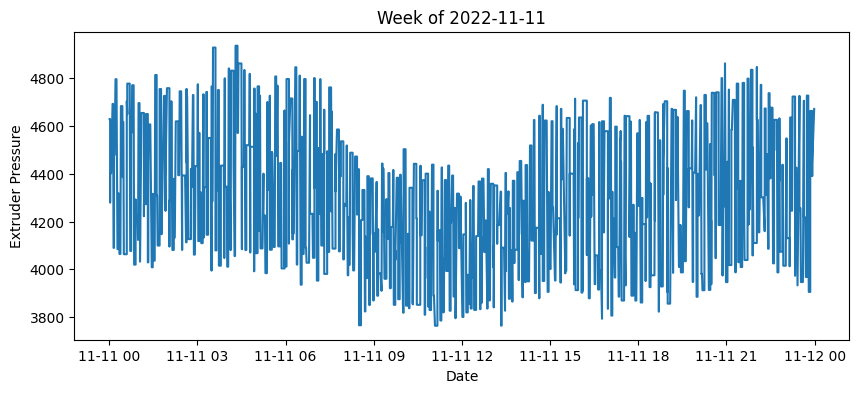

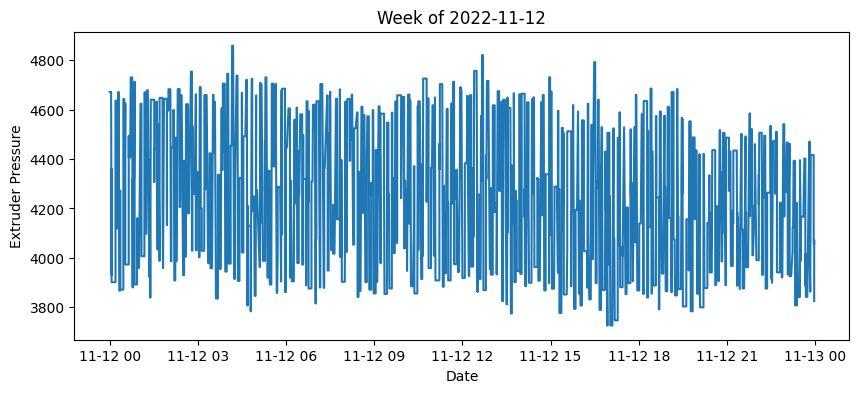

...

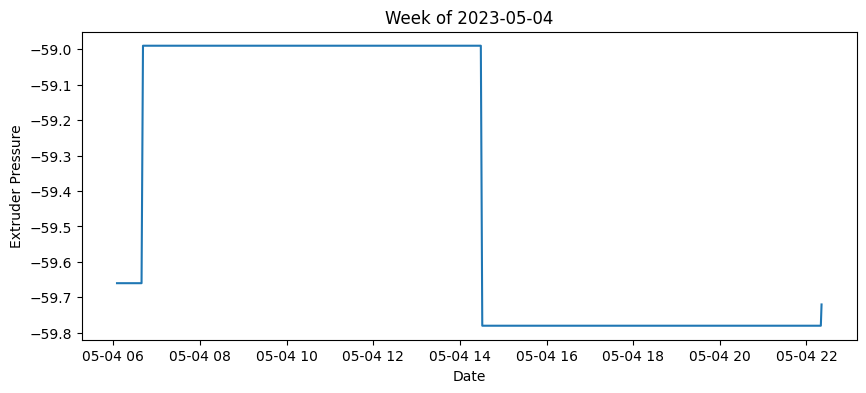

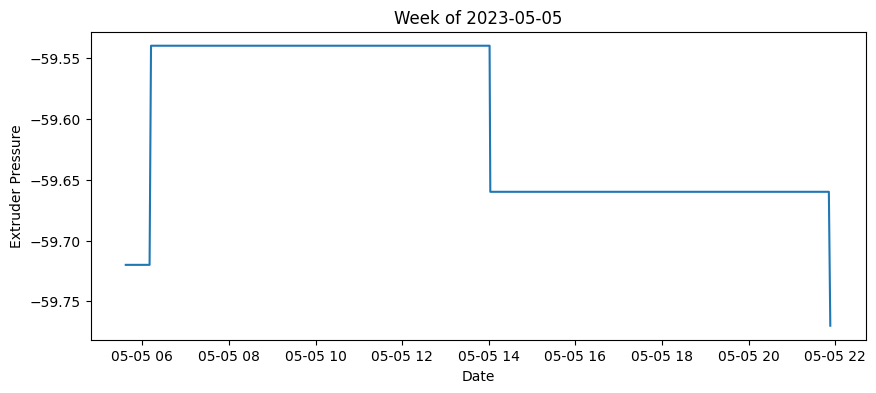

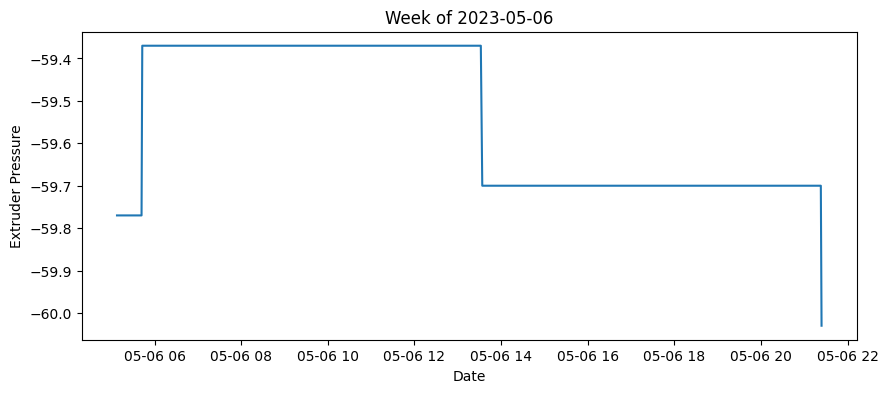

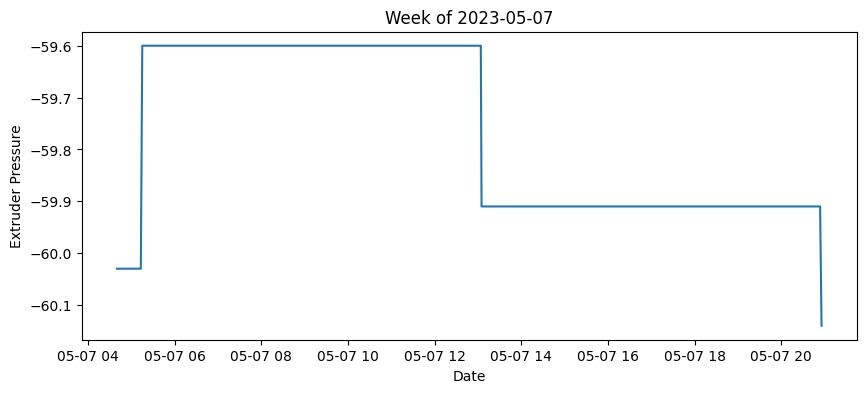

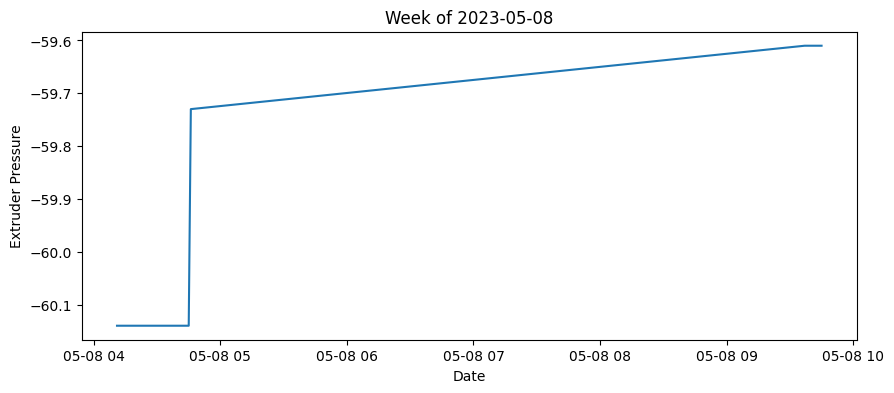

In [11]:
plot_weekly_data(extruder_data, 'Date and Time', 'Extruder Pressure')

In [46]:
extruder_data['Extruder Pressure'].mean()

3912.093890991381

In [58]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import pandas as pd
import numpy as np

inp_data = cleaned_data.drop('Date and Time', axis=1)
target = 'Extruder Pressure'
# Define the features and target variable
X = inp_data.drop(target, axis=1)  # Features (all columns except 'Target')
y = inp_data[target]               # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize XGBoost regressor
xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', n_estimators = 10, seed = 123)

# Fit the model to the training set
xg_reg.fit(X_train, y_train)

# Predict the target on the test set
y_pred = xg_reg.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 37515062.26904031


In [24]:
extruder_data['time_diff'] = extruder_data['Date and Time'].diff()

In [27]:
extruder_data.head()

# pressure elevated and then dropped, 

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),time_diff
1,2022-11-08 08:45:00,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,NaT
2,2022-11-08 08:46:00,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,0 days 00:01:00
3,2022-11-08 08:46:00,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,0 days 00:00:00
4,2022-11-08 08:49:00,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,0 days 00:03:00
5,2022-11-08 08:50:00,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,0 days 00:01:00


In [35]:
#extruder_data['time_diff'].hist()
extruder_data['time_diff_minutes'] = extruder_data['time_diff'].dt.total_seconds()/60
extruder_data['time_diff_minutes'].max()

8966.0

<Axes: ylabel='Frequency'>

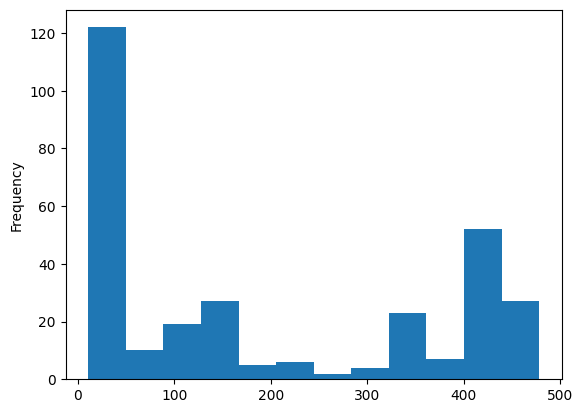

In [43]:
mask = (extruder_data['time_diff_minutes'] > 10) & (extruder_data['time_diff_minutes'] < 500)
extruder_data[mask]['time_diff_minutes'].plot(kind='hist', bins=12)

In [53]:
!pip install xgboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.1/297.1 MB 6.9 MB/s eta 0:00:00m eta 0:00:010:00:01


In [34]:
pd.set_option('display.max_columns', None)
#df

In [39]:
test = new_df[new_df[extruder].notnull()]

In [41]:
test.head(50)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Lbs per 30 seconds * 120 / 2000,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,datetime
1,NaN,NaN,NaN,NaN,Comments,NaN,Extruder 1,NaN,NaN,NaN,NaN,Extruder 2,NaN,NaN,NaN,NaN,Extruder 3,NaN,NaN,NaN,NaN,Extruder 4\n*TEST*,NaN,NaN,NaN,NaN,NaN,PRODUCTION ENTRY,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,Date,Shift,Incoming Lead Sign Off:,Outgoing Lead Sign off:,Notes,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,NaN,Tons,Pounds,NaN,NaN,NaN,Sid,1st,NaT
3,2022-11-08 00:00:00,1st,Cody,NaN,moved 115.78 of cubes to hoop barn,NaN,DDG,12,NaN,2.5,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.1,NaN,DDG,12,NaN,2.46,114.24000,NaN,114.24,228480,NaN,NaN,NaN,NaN,NaN,2022-11-08
4,2022-11-08 00:00:00,2nd,Sid,NaN,ran good,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.42,NaN,DDG,12,NaN,2.13,NaN,DDG,12,NaN,2.44,113.40000,NaN,113.4,226800,NaN,NaN,NaN,NaN,NaN,2022-11-08
5,2022-11-09 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,43.167,2.59002,NaN,DDG,12,46,2.76,NaN,DDG,12,38,2.28,NaN,DDG,12,45.167,2.71002,124.08048,NaN,124.08048,248160.96,NaN,NaN,NaN,NaN,NaN,2022-11-09
6,2022-11-09 00:00:00,2nd,Taylor,NaN,ran good,NaN,DDG,12,42.3,2.538,NaN,DDG,12,47.3,2.838,NaN,DDG,12,39,2.34,NaN,DDG,12,45.8,2.748,125.56800,NaN,125.568,251136,NaN,NaN,NaN,NaN,NaN,2022-11-09
7,2022-11-10 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,42.5,2.55,NaN,DDG,12,45.7,2.742,NaN,DDG,12,38,2.28,NaN,DDG,12,45,2.7,123.26400,NaN,123.264,246528,NaN,NaN,NaN,NaN,NaN,2022-11-10
8,2022-11-10 00:00:00,2nd,taylor,NaN,ran good,NaN,DDG,12,44.3,2.658,NaN,DDG,12,49.3,2.958,NaN,DDG,12,40.8,2.448,NaN,DDG,12,46,2.76,129.88800,NaN,129.888,259776,NaN,NaN,NaN,NaN,NaN,2022-11-10
9,2022-11-11 00:00:00,1st,Cody,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43.3,2.598,NaN,DDG,12,39.4,2.364,NaN,DDG,12,43,2.58,120.74400,NaN,120.744,241488,NaN,NaN,NaN,NaN,NaN,2022-11-11
10,2022-11-11 00:00:00,2nd,Sid,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43,2.58,NaN,DDG,12,38,2.28,NaN,DDG,12,42.5,2.55,119.16000,NaN,119.16,238320,NaN,NaN,NaN,NaN,NaN,2022-11-11


In [38]:
new_df.head(50)

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Lbs per 30 seconds * 120 / 2000,Unnamed: 14,Unnamed: 15,Unnamed: 16,Unnamed: 17,Unnamed: 18,Unnamed: 19,Unnamed: 20,Unnamed: 21,Unnamed: 22,Unnamed: 23,Unnamed: 24,Unnamed: 25,Unnamed: 26,Unnamed: 27,Unnamed: 28,Unnamed: 29,Unnamed: 30,Unnamed: 31,Unnamed: 32,Unnamed: 33,datetime
1,NaN,NaN,NaN,NaN,Comments,NaN,Extruder 1,NaN,NaN,NaN,NaN,Extruder 2,NaN,NaN,NaN,NaN,Extruder 3,NaN,NaN,NaN,NaN,Extruder 4\n*TEST*,NaN,NaN,NaN,NaN,NaN,PRODUCTION ENTRY,NaN,NaN,NaN,NaN,NaN,NaN,NaT
2,Date,Shift,Incoming Lead Sign Off:,Outgoing Lead Sign off:,Notes,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,Product,Hours Run,Pounds,Rate,NaN,NaN,Tons,Pounds,NaN,NaN,NaN,Sid,1st,NaT
3,2022-11-08 00:00:00,1st,Cody,NaN,moved 115.78 of cubes to hoop barn,NaN,DDG,12,NaN,2.5,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.1,NaN,DDG,12,NaN,2.46,114.24000,NaN,114.24,228480,NaN,NaN,NaN,NaN,NaN,2022-11-08
4,2022-11-08 00:00:00,2nd,Sid,NaN,ran good,NaN,DDG,12,NaN,2.46,NaN,DDG,12,NaN,2.42,NaN,DDG,12,NaN,2.13,NaN,DDG,12,NaN,2.44,113.40000,NaN,113.4,226800,NaN,NaN,NaN,NaN,NaN,2022-11-08
5,2022-11-09 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,43.167,2.59002,NaN,DDG,12,46,2.76,NaN,DDG,12,38,2.28,NaN,DDG,12,45.167,2.71002,124.08048,NaN,124.08048,248160.96,NaN,NaN,NaN,NaN,NaN,2022-11-09
6,2022-11-09 00:00:00,2nd,Taylor,NaN,ran good,NaN,DDG,12,42.3,2.538,NaN,DDG,12,47.3,2.838,NaN,DDG,12,39,2.34,NaN,DDG,12,45.8,2.748,125.56800,NaN,125.568,251136,NaN,NaN,NaN,NaN,NaN,2022-11-09
7,2022-11-10 00:00:00,1st,Lucas,NaN,NaN,NaN,DDG,12,42.5,2.55,NaN,DDG,12,45.7,2.742,NaN,DDG,12,38,2.28,NaN,DDG,12,45,2.7,123.26400,NaN,123.264,246528,NaN,NaN,NaN,NaN,NaN,2022-11-10
8,2022-11-10 00:00:00,2nd,taylor,NaN,ran good,NaN,DDG,12,44.3,2.658,NaN,DDG,12,49.3,2.958,NaN,DDG,12,40.8,2.448,NaN,DDG,12,46,2.76,129.88800,NaN,129.888,259776,NaN,NaN,NaN,NaN,NaN,2022-11-10
9,2022-11-11 00:00:00,1st,Cody,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43.3,2.598,NaN,DDG,12,39.4,2.364,NaN,DDG,12,43,2.58,120.74400,NaN,120.744,241488,NaN,NaN,NaN,NaN,NaN,2022-11-11
10,2022-11-11 00:00:00,2nd,Sid,NaN,NaN,NaN,DDG,12,42,2.52,NaN,DDG,12,43,2.58,NaN,DDG,12,38,2.28,NaN,DDG,12,42.5,2.55,119.16000,NaN,119.16,238320,NaN,NaN,NaN,NaN,NaN,2022-11-11


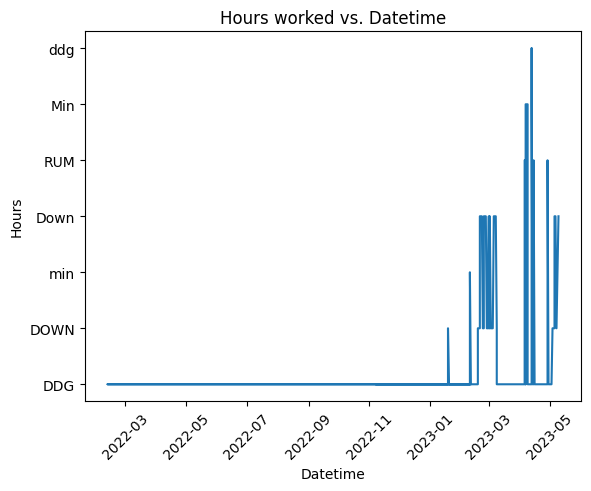

In [36]:
import pandas as pd
import matplotlib.pyplot as plt

# Plot the graph
plt.plot(new_df['datetime'], new_df[extruder])
plt.xlabel('Datetime')
plt.ylabel('Hours')
plt.title('Hours worked vs. Datetime')
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.show()

/tmp/ipykernel_7555/2893120587.py:4: DtypeWarning: Columns (2,3,4,5,6,7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  extruder_data = pd.read_csv("ex4-data.csv",)


In [7]:
extruder_data.head().T

,1,2,3,4,5
Date and Time,11/8/2022 8:45 AM,11/8/2022 8:46 AM,11/8/2022 8:46 AM,11/8/2022 8:49 AM,11/8/2022 8:50 AM
Extruder Pressure,4174.38,4521.09,4521.09,4521.09,4521.09
Screw Speed Output,63.1,63.1,63.1,63.1,63.1
Screw Speed,-0.94,-0.94,-0.94,-0.94,-0.94
Extruder Die Temp,11.28,11.28,11.28,11.28,11.28
Extruder Thrust,34.12,34.12,34.62,34.62,34.62
Feed Screw Current (Amps),5.21,5.21,5.21,5.21,5.21
Discharge Conveyor Current (Amps),0.95,0.95,0.95,1.01,0.9
Discharge Conveyor Speed (%),75.36,75.36,75.36,75.36,75.36


In [22]:
extruder_data.head(50)

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%)
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36
6,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,33.45,5.21,0.90,75.36
7,11/8/2022 8:53 AM,4521.09,63.1,-0.94,11.28,33.45,5.22,0.90,75.36
8,11/8/2022 8:53 AM,4521.09,63.1,-0.94,11.28,33.45,0.00,0.90,75.36
9,11/8/2022 8:53 AM,3969.78,63.1,-0.94,11.28,33.45,0.00,0.90,75.36
10,11/8/2022 8:54 AM,3969.78,63.1,-0.94,11.28,34.11,0.00,0.90,75.36


<Axes: >

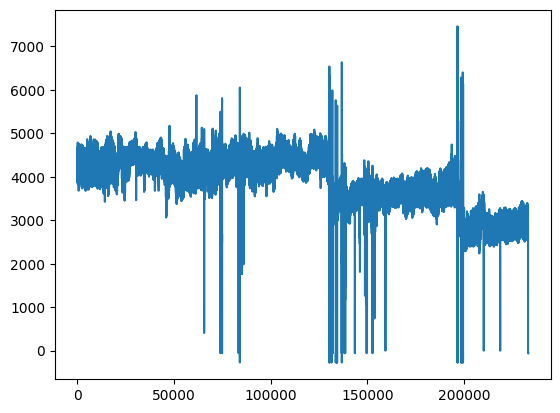

In [25]:
#extruder_data[extruder_data['Extruder Pressure'] < 1]['Extruder Pressure'].plot()
#extruder_data['Extruder Pressure'].plot()
extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure'].plot()
plt.plot()

In [59]:
extruder_data['outlier'] = (extruder_data['Extruder Pressure'] > 5100)

In [60]:
extruder_data.head()

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),outlier
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,False
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,False
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,False


In [ ]:
extruder_data[extruder_data['Extruder Pressure'] < 1]['Extruder Pressure'].plot()

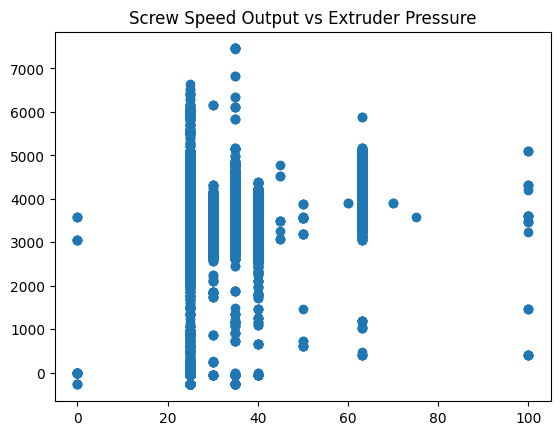

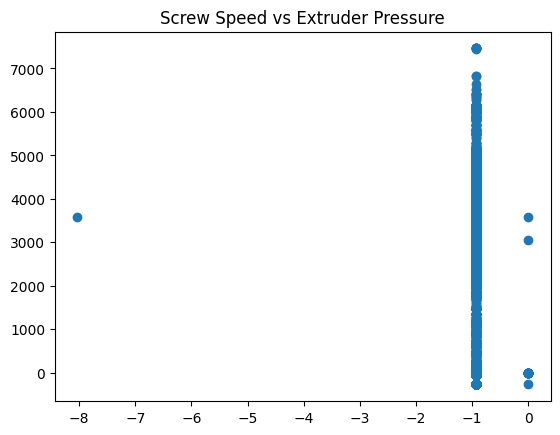

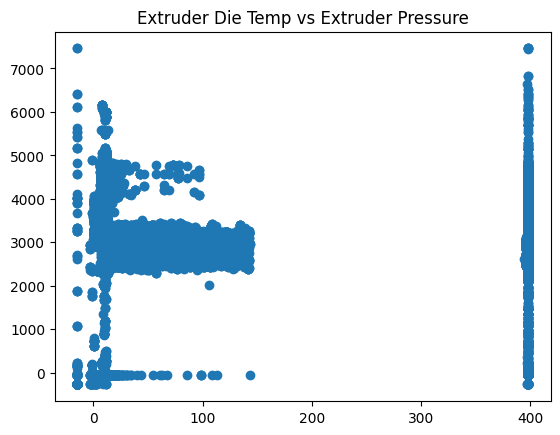

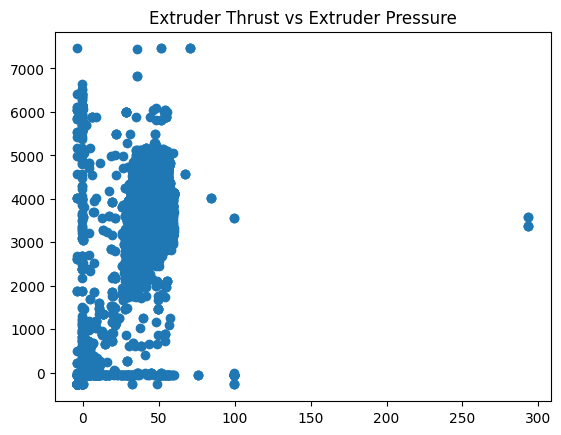

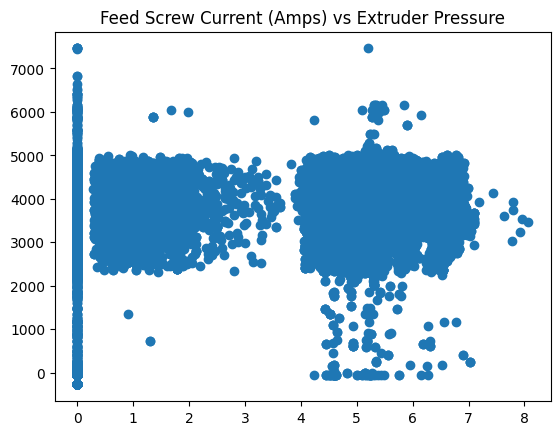

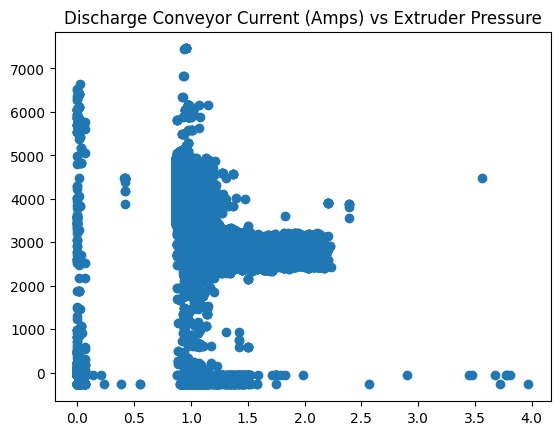

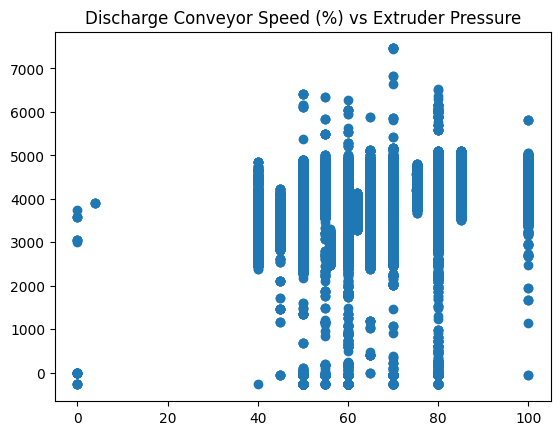

In [26]:
import matplotlib.pyplot as plt

output_channel = 'Extruder Pressure'

input_channels = ['Screw Speed Output', 
                  'Screw Speed', 
                  'Extruder Die Temp',
                 'Extruder Thrust',
                 'Feed Screw Current (Amps)',
                 'Discharge Conveyor Current (Amps)',
                 'Discharge Conveyor Speed (%)']

for inpt in input_channels:
    
    dependent = extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure']
    independent = extruder_data[extruder_data['Extruder Pressure'] < 1e5][inpt]
    
    plt.scatter(independent, dependent)
    plt.title(f'{inpt} vs Extruder Pressure')
    plt.show()

<Axes: >

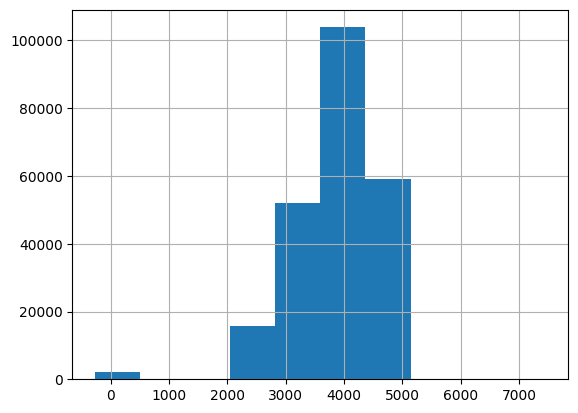

In [42]:
extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure'].hist()

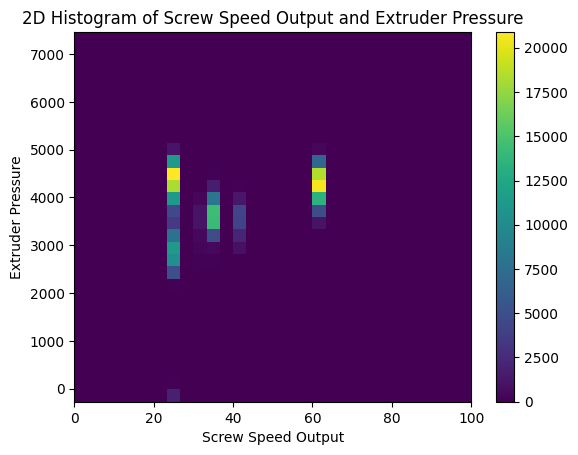

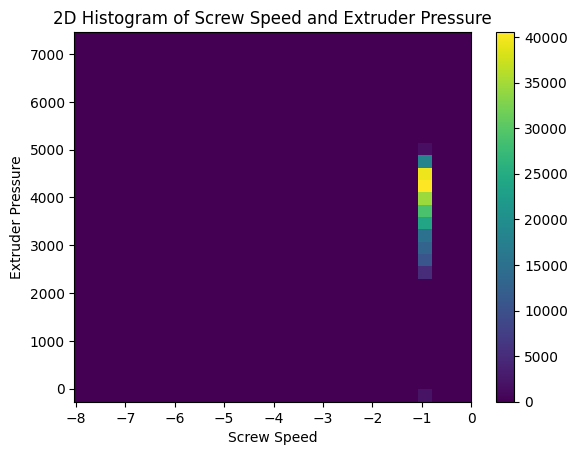

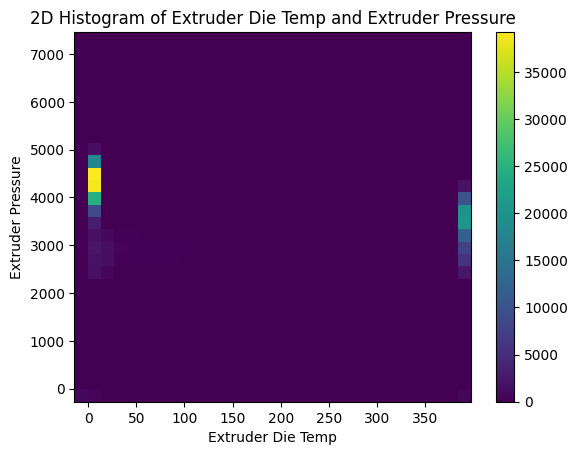

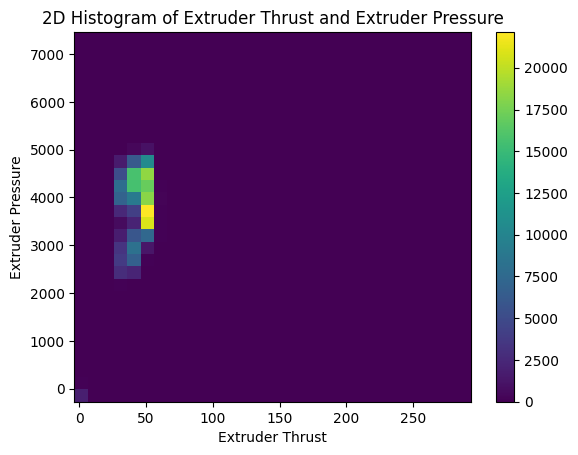

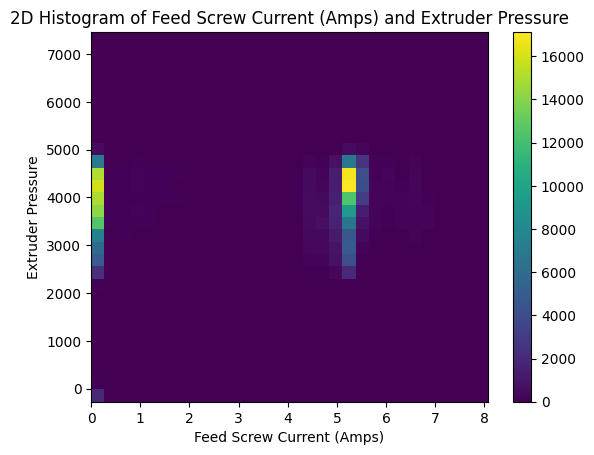

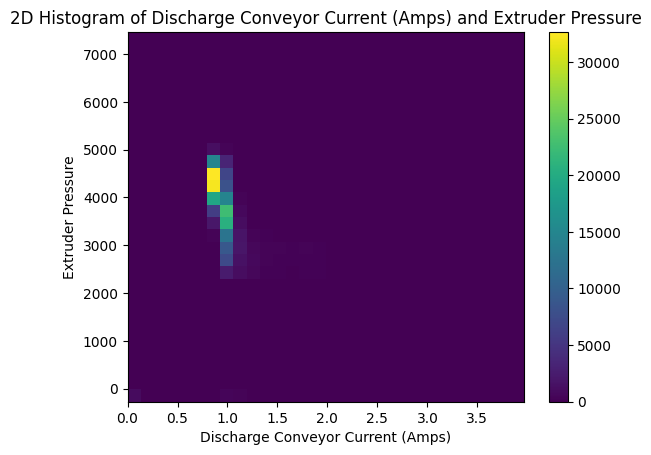

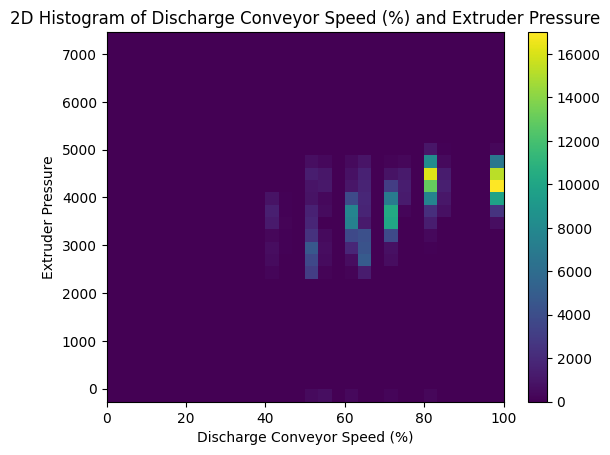

In [44]:
# Example DataFrame with two normally distributed columns


for inpt in input_channels:
    
    dependent = extruder_data[extruder_data['Extruder Pressure'] < 1e5]['Extruder Pressure']
    independent = extruder_data[extruder_data['Extruder Pressure'] < 1e5][inpt]

    # Plotting the 2D histogram for the DataFrame columns
    plt.hist2d(independent, dependent, bins=30)
    plt.colorbar()  # To show the color scale
    plt.title(f'2D Histogram of {inpt} and Extruder Pressure')
    plt.xlabel(inpt)
    plt.ylabel('Extruder Pressure')
    plt.show()

In [45]:
import pandas as pd
import matplotlib.pyplot as plt

def calculate_correlations(data, target_column, 
                           ascending=False, 
                           include_categorical=True
):
    # Calculate correlations for numerical columns with the target variable
    if include_categorical:
        data_encoded = handle_categorical_columns(data)
        included_features = data_encoded.columns.tolist()
    else:
        data_encoded = data
        included_features = data.select_dtypes(exclude=['object']).columns.tolist()
        
    numerical_correlations = data_encoded[included_features].corr()[target_column].abs()
    
    return numerical_correlations.sort_values(ascending=ascending)

def handle_categorical_columns(data):
    # Separate categorical and numerical columns
    categorical_cols = data.select_dtypes(include=['object']).columns.tolist()
    
    if not categorical_cols:
        return data
    
    # Handle categorical columns (one-hot encoding)
    data_encoded = pd.get_dummies(data, columns=categorical_cols, drop_first=True)
    return data_encoded

def plot_correlation_bar(correlations, 
                         top_n=10, 
                         show_values=False
):
    # Create a bar plot
    fig, ax = plt.subplots(figsize=(10, 6))
    bars = correlations[:top_n].plot(kind='bar', color='skyblue', ax=ax)
    plt.title(f'Top {top_n} Correlated Features')
    plt.xlabel('Feature')
    plt.ylabel('Correlation')
    plt.xticks(rotation=90)
    plt.tight_layout()
    
    # Optionally add correlation values above each bar
    if show_values:
        for bar in bars.patches:
            ax.annotate(
                f'{bar.get_height():.2f}', (bar.get_x() + bar.get_width() / 2, bar.get_height()),
                ha='center', va='bottom'
            )
    
    plt.show()

def select_top_correlated_features(data, target_column, 
                                   top_n=10, 
                                   show_values=False,
                                   ascending=False):

    correlations = calculate_correlations(data, target_column)
    # Plot the top correlated features with optional values
    plot_correlation_bar(correlations, top_n, show_values)
    
    # Return both the correlations and the top N correlated feature names
    top_feature_names = correlations.index.tolist()[:top_n]
    return correlations, top_feature_names

# Example usage:
# Assuming you have a DataFrame 'df' with mixed data types and the target variable is '


In [71]:
cleaned_data = extruder_data[extruder_data['Extruder Pressure'].notnull()]

cleaned_data = cleaned_data[cleaned_data['Extruder Pressure'] < 1e5]
cleaned_data = cleaned_data[cleaned_data['Extruder Thrust'] < 70]
cleaned_data = cleaned_data[cleaned_data['Extruder Thrust'] > 25]

In [75]:
extruder_data['Date and Time'].min(), extruder_data['Date and Time'].max()

('1/1/2023 10:00 AM', '5/8/2023 9:45 AM')

In [50]:
cleaned_data.shape

(233321, 9)

In [62]:
cleaned_data.head()

,Date and Time,Extruder Pressure,Screw Speed Output,Screw Speed,Extruder Die Temp,Extruder Thrust,Feed Screw Current (Amps),Discharge Conveyor Current (Amps),Discharge Conveyor Speed (%),outlier
1,11/8/2022 8:45 AM,4174.38,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
2,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.12,5.21,0.95,75.36,False
3,11/8/2022 8:46 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.95,75.36,False
4,11/8/2022 8:49 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,1.01,75.36,False
5,11/8/2022 8:50 AM,4521.09,63.1,-0.94,11.28,34.62,5.21,0.90,75.36,False


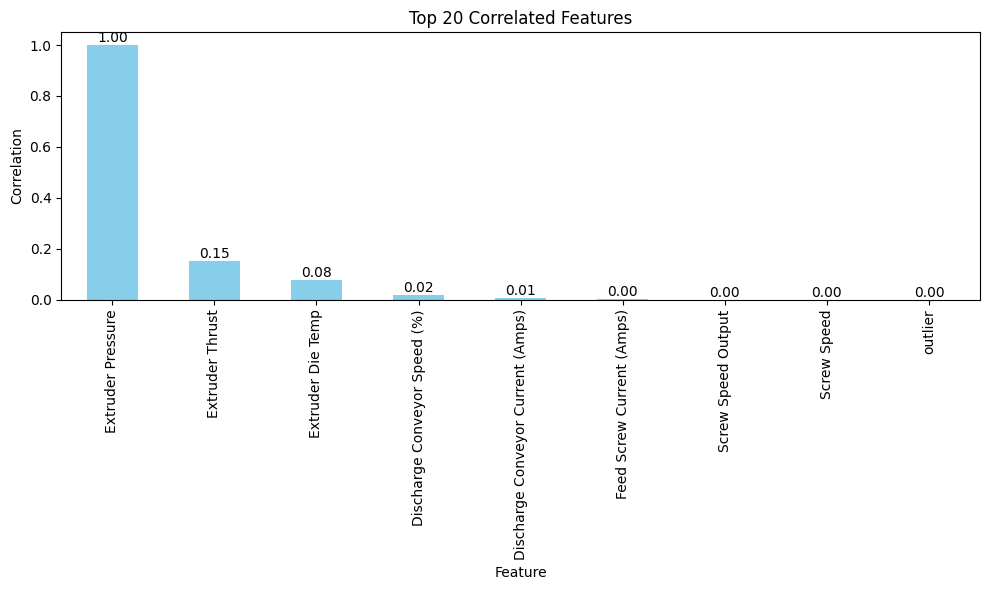

In [66]:
correlations, selected_features = select_top_correlated_features(
    cleaned_data[:10000].drop('Date and Time', axis=1), 'Extruder Pressure', top_n=20, show_values=True)

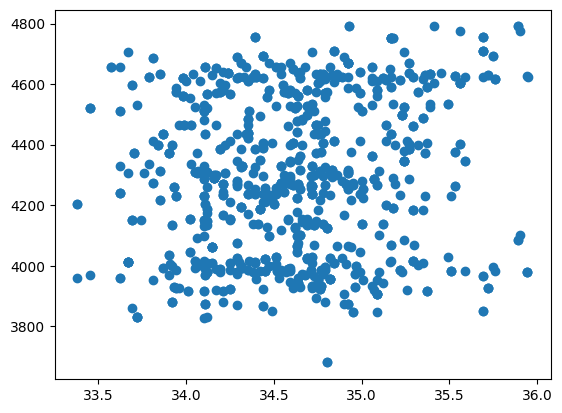

In [74]:
plt.scatter(cleaned_data[:1000]['Extruder Thrust'], cleaned_data[:1000]['Extruder Pressure'])

<Axes: >

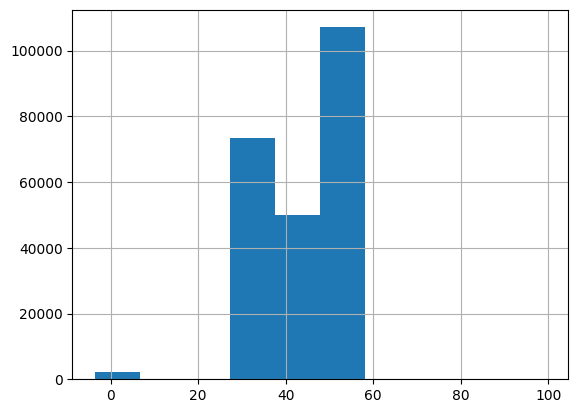

In [68]:
cleaned_data['Extruder Thrust'].hist()

In [ ]:
correlations, selected_features = select_top_correlated_features(
    cleaned_data[10000:20000], 'Extruder Pressure', top_n=20, show_values=True)

In [76]:
def plot_weekly_data(df, datetime_col, numeric_col):
    """
    Plots a separate line plot for each week of data in the DataFrame.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the data.
    datetime_col (str): The name of the column with datetime objects.
    numeric_col (str): The name of the numeric column to plot.
    """
    # Convert the datetime column to pandas datetime type if it's not already
    df[datetime_col] = pd.to_datetime(df[datetime_col])

    # Set the datetime column as the index of the DataFrame
    df.set_index(datetime_col, inplace=True)

    # Resample the data by week and plot each week
    for week, weekly_data in df[numeric_col].resample('W'):
        plt.figure(figsize=(10, 4))
        plt.plot(weekly_data.index, weekly_data.values)
        plt.title(f"Week of {week.strftime('%Y-%m-%d')}")
        plt.xlabel('Date')
        plt.ylabel(numeric_col)
        plt.show()

In [7]:
extruder_data["Screw Speed"]

1        -0.94
2        -0.94
3        -0.94
4        -0.94
5        -0.94
          ... 
233317   -0.94
233318   -0.94
233319   -0.94
233320   -0.94
233321   -0.94
Name: Screw Speed, Length: 233321, dtype: float64

In [ ]:
def plot_weekly_data(df, datetime_col, numeric_col):
    """
    Plots a separate line plot for each week of data in the DataFrame.

    Parameters:
    df (pandas.DataFrame): The DataFrame containing the data.
    datetime_col (str): The name of the column with datetime objects.
    numeric_col (str): The name of the numeric column to plot.
    """
    # Convert the datetime column to pandas datetime type if it's not already
    df[datetime_col] = pd.to_datetime(df[datetime_col])

    # Set the datetime column as the index of the DataFrame
    df.set_index(datetime_col, inplace=True)

    # Resample the data by week and plot each week
    for week, weekly_data in df[numeric_col].resample('W'):
        plt.figure(figsize=(10, 4))
        plt.plot(weekly_data.index, weekly_data.values)
        plt.title(f"Week of {week.strftime('%Y-%m-%d')}")
        plt.xlabel('Date')
        plt.ylabel(numeric_col)
        plt.show()

In [8]:
import pandas as pd
from sklearn.neighbors import LocalOutlierFactor
import numpy as np

def detect_outliers_larger_than(df, column_name, n_neighbors=3, contamination=0.1, threshold=None):

    column_data = df[column_name]
    # Reshape the data to have a single feature
    column_data_reshaped = column_data.values.reshape(-1, 1)

    lof = LocalOutlierFactor(n_neighbors=n_neighbors, contamination=contamination)

    # Fit the model to the column data
    lof.fit(column_data_reshaped)

    # Predict the anomaly scores
    anomaly_scores = lof.negative_outlier_factor_

    # Add the anomaly scores to the DataFrame
    df['AnomalyScore'] = anomaly_scores
    
    threshold = np.abs(df['AnomalyScore']).quantile(threshold)

    # Select the top 5% values using boolean indexing
    top_5_percent = df[np.abs(df['AnomalyScore']) > threshold]

    return top_5_percent

In [9]:
import pandas as pd
from sklearn.neighbors import LocalOutlierFactor

def detect_outliers(df, column_name, n_neighbors=3, contamination=0.1, threshold_lower=None, threshold_upper=None):

    column_data = df[column_name]

    # Reshape the data to have a single feature
    column_data_reshaped = column_data.values.reshape(-1, 1)

    lof = LocalOutlierFactor(n_neighbors=n_neighbors, contamination=contamination)

    # Fit the model to the column data
    lof.fit(column_data_reshaped)

    # Predict the anomaly scores
    anomaly_scores = lof.negative_outlier_factor_

    # Add the anomaly scores to the DataFrame
    df['AnomalyScore'] = anomaly_scores

    # Identify the anomalies based on the condition
    if threshold_lower is not None and threshold_upper is not None:
        threshold_lower_value = np.abs(df['AnomalyScore']).quantile(threshold_lower)
        threshold_upper_value = np.abs(df['AnomalyScore']).quantile(threshold_upper)
        
        print(threshold_lower_value, threshold_upper_value)
        anomalies = df[(df['AnomalyScore'].abs() > threshold_lower_value) & (df['AnomalyScore'].abs() < threshold_upper_value)]
    else:
        anomalies = df

    return anomalies

In [10]:
def plot_line_graph_with_collapsed_points(new_df, points_df, original, column_name, title):
    # Convert 'date' column to datetime type in new_df
    new_df['date'] = pd.to_datetime(new_df['datetime'], errors='coerce')

    # Convert 'datetime' column to datetime type in points_df
    points_df['datetime'] = pd.to_datetime(points_df['Date and Time'], errors='coerce').dt.date

    # Group points_df by 'datetime' and aggregate 'column_name' using mean
    points_df_collapsed = points_df.groupby('datetime')[column_name].mean().reset_index()

    # Plot the line graph with dates data
    fig, ax1 = plt.subplots(figsize=(20,12))
    
    # Plot the line graph on the left y-axis
    ax1.plot(new_df['date'], new_df[extruder], label='Hours Worked')
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Hours Worked')

    # Create a second y-axis for 'Extruder Pressure' values
    ax2 = ax1.twinx()

    # Plot the 'Extruder Pressure' values on the right y-axis
    ax2.scatter(points_df_collapsed['datetime'], points_df_collapsed[column_name], color='red',
                label=f'Mean Daily {column_name}')

    # Add a plate to label the mean extruder pressure
    # for i, row in points_df_collapsed.iterrows():
    #     ax2.annotate(round(row[column_name], 2), (row['datetime'], row[column_name]),
    #                  xytext=(5, 0), textcoords='offset points', ha='left', va='bottom')
    mean_value = original[column_name].mean()
    ax2.annotate(f'{column_name} Mean: {str(round(mean_value, 2))}', (new_df['datetime'].iloc[0],
                                                                  mean_value),
                 xytext=(-200, -100), textcoords='offset points', ha='left', va='bottom', color='darkorange')
    ax2.set_ylabel(column_name)

    # Rotate x-axis labels for better visibility
    plt.xticks(rotation=45)

    # Show legend
    ax1.legend(loc='upper left')
    ax2.legend(loc='lower left')

    # Title for the plot
    plt.title(f"{title}")

    plt.show()

In [11]:
column_name = "Extruder Pressure"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.995)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

133333334.33018042 333333334.334546


NameError: name 'new_df' is not defined

In [ ]:
column_name = "Screw Speed Output"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Screw Speed"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Extruder Die Temp"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Extruder Thrust"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Feed Screw Current (Amps)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Discharge Conveyor Current (Amps)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")

In [ ]:
column_name = "Discharge Conveyor Speed (%)"
larger_than_anomalies = detect_outliers_larger_than(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold=0.99)

anomalies = detect_outliers(extruder_data, column_name, n_neighbors=3, contamination=0.1,
                            threshold_lower=.95, threshold_upper=.99)
plot_line_graph_with_collapsed_points(new_df, larger_than_anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")
plot_line_graph_with_collapsed_points(new_df, anomalies, extruder_data, column_name, f"Upper Range {column_name} Anomalies")